# A notebook for simulating the single ring attractor

We want to simulate the following dynamical equation, $$ \tau \frac{dv(\theta)}{dt} = - v(\theta) + \phi\left( \int_{S^1} d\theta' \ W(\theta - \theta') v(\theta') + I \right),$$ where $\phi(x) = x \Theta(x)$, the integral of the Heaviside step function.

The connectivity we choose is $W(\theta - \theta') = W_0 + W_1 \cos(\theta-\theta')$ with a constant biasing/input current $I$.

We will also include an antisymmetric term to the connectivity to see what happens. i.e., $W = W_0 + W_1 \cos(\theta - \theta') + \alpha \sin(\theta-\theta')$.

#### Importing stuff

In [11]:
import numpy as np
import matplotlib.pyplot as plt
#from mpl_toolkits.mplot3d import Axes3D

%matplotlib ipympl

# importing animation from matplotlib
from matplotlib.animation import FuncAnimation

#importing something to display the animation in a jupyter notebook
from IPython.display import HTML


np.set_printoptions(precision=4) #this is to set the floating point precision

In [ ]:
import scipy

import matplotlib.pyplot as plt

# Create two random vector arrays
x = scipy.random.rand(100)
y = scipy.random.rand(100)

# Create a scatterplot
plt.scatter(x, y)
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Scatterplot of Random Vector Arrays')
plt.show()

#### Defining some variables

In [12]:
max_neuron_no = 360 #total number of neurons

theta_c = [2*np.pi*i/max_neuron_no for i in range(max_neuron_no)] #theta values uniformly sampled from a circle

#----------------------
#Creating a new list of theta_c in units of pi, may be useful in plotting
theta_pi = [2*i/max_neuron_no for i in range(max_neuron_no)] 
#------------------------

#parameters in the connectivity profile. We know the limits of stability of these parameters from analytical understanding
w1 = -2 # to simulate the connectivity
w2 = 1 
alpha = 0.3
#This is to define the connectivity
w_cosine = np.zeros((max_neuron_no,max_neuron_no))

for i in range(max_neuron_no):
    for j in range(max_neuron_no):
        w_cosine[i][j] = w1 + w2 * np.cos(theta_c[i]-theta_c[j])  # + alpha * np.sin(theta_c[i]-theta_c[j])
    

#### Dynamics starts here

In [13]:
#defining the membrane potential
steps = 800
t_step = 0.005
tau = 0.1 #time constant for the dynamics
#v = np.zeros((steps,len(theta_c)))
v = np.random.rand(steps,len(theta_c))*0.01 #initialise all the voltages at the first time step arbitrarily
u = 0.0
I = 0.1 #constant bias



#integrating to future time steps
for t in range(steps-1):
    for i in range(len(theta_c)):
        for j in range(len(theta_c)):
            u = u + w_cosine[i][j]*v[t][j]
#        v[t+1][i] = (1-1/tau)*v[t][i] + max(u + I,0)
        v[t+1][i] = v[t][i] + t_step/tau *( - v[t][i] + max(u + I,0))
       # if i==3:
       #     print(t,u)
        u=0


#### Plotting stuff

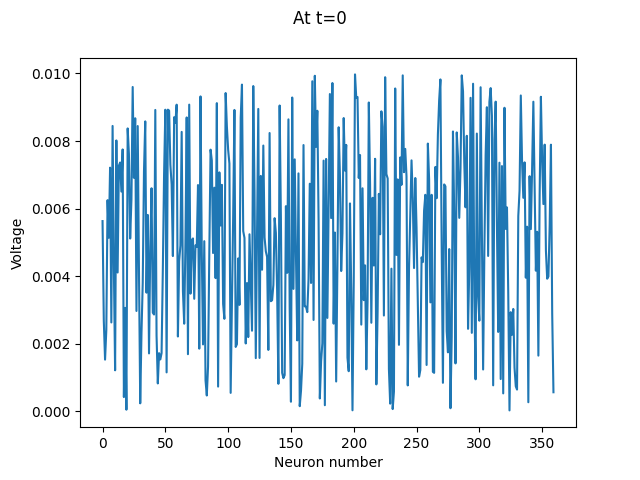

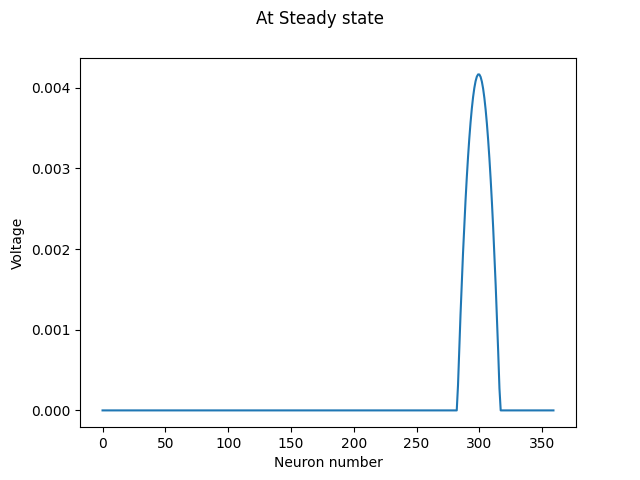

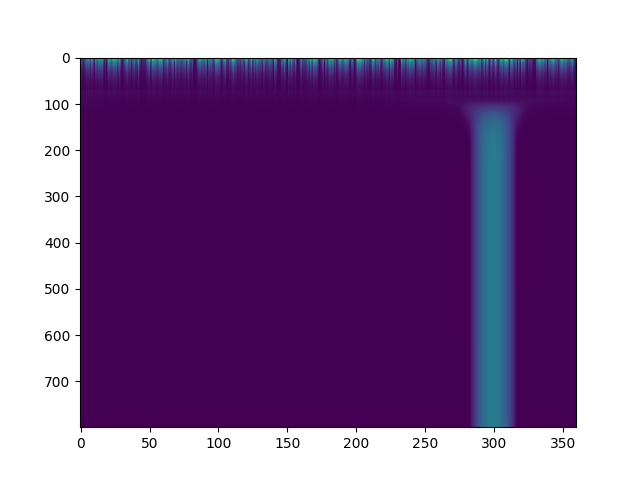

In [14]:
#fig = plt.figure()
#at t=0
fig0, ax0 = plt.subplots()
fig0.suptitle('At t=0')
ax0.plot(v[0])
ax0.set_xlabel('Neuron number')
ax0.set_ylabel('Voltage')



#at steady state
fig1, ax1 = plt.subplots()
fig1.suptitle('At Steady state')
ax1.plot(v[steps-1])
ax1.set_xlabel('Neuron number')
ax1.set_ylabel('Voltage')

fig3 = plt.figure()
ax3 = fig3.add_subplot()
ax3.imshow(v, aspect='auto')
#fig3.show()

#### Animation for fun

_The animation code is pretty fun. I have no idea how it works, ChatGPT helped. But it may increase runtime or memory usage. Comment it out if it is computationally expensive_

Animation size has reached 20995510 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


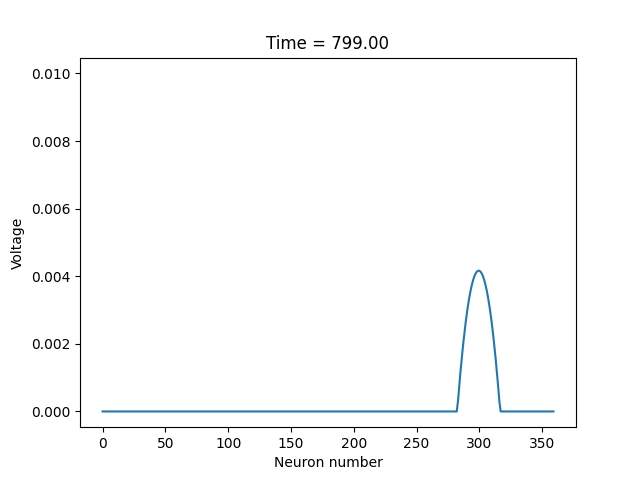

In [15]:
#Let us define a figure for a single frame,

fig_ani = plt.figure()
ax_ani = fig_ani.add_subplot()

line, = ax_ani.plot(v[0])
ax_ani.set_xlabel('Neuron number')
ax_ani.set_ylabel('Voltage')


# Animation function
def update(frame):
    line.set_ydata(v[frame])
    ax_ani.set_title(f'Time = {frame:0.2f}')
    return line,

# Set up the animation
ani = FuncAnimation(fig_ani, update, frames=steps,
                    interval=25, blit=True)

# Display the animation in the notebook
HTML(ani.to_jshtml())